In [1]:
import os
import sys
sys.path.append('..')
from src import RASPRoutines

RASP = RASPRoutines.RASP_Routines()
import pandas as pd
from src import AnalysisFunctions

A_F = AnalysisFunctions.Analysis_Functions()
from src import IOFunctions

from src import Image_Analysis_Functions

IA_F = Image_Analysis_Functions.ImageAnalysis_Functions()

from src import CoincidenceFunctions

C_F = CoincidenceFunctions.Coincidence_Functions()

from src import HelperFunctions
H_F = HelperFunctions.Helper_Functions()

IO = IOFunctions.IO_Functions()
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

from src import PlottingFunctions

plotter = PlottingFunctions.Plotter()

import polars as pl
from scipy.signal import fftconvolve, convolve
from scipy.ndimage import binary_opening, binary_closing, binary_fill_holes
import skimage as ski

from scipy import stats

from scipy import ndimage as ndi
from skimage import (exposure, feature, filters, io, measure,
                      morphology, restoration, segmentation, transform,
                      util)
from skimage.measure import label, regionprops_table
import napari

In [2]:
frontal_region = r'S:\ASAP_Imaging_Data\Main_Survey\20241105_oligomers_in_cells\frontal\microglia\PD_analysis'
oligomer_data = pl.read_csv(os.path.join(frontal_region, 'spot_analysis.csv'))

In [3]:
folder_to_save = r'C:\Users\jsb92\Cambridge University Dropbox\Joseph Beckwith\Chemistry\Lee\Code\Python\pyRASP\example_images_analysis\For_ASAP_Paper'

In [12]:
filenames = np.unique(oligomer_data['image_filename'].to_numpy())

In [5]:
def microglia_image_saver(filenames, analysis_folder, folder_to_save, protein_string='C1', cell_string='C0', lower_object_size=2000, lower_hole_size=100):
    for filename in filenames:
        cell_filename = filename.split(protein_string+'.tif')[0]+cell_string+'.tif'
        raw_cell_image = np.nanmax(IO.read_tiff_tophotons(cell_filename), axis=0)
        
        mask = np.array(IO.read_tiff(os.path.join(analysis_folder, os.path.split(filename)[-1].split(protein_string+'.tif')[0]+cell_string+'_cellMask.tiff')), dtype=bool)
        filled = ndi.binary_fill_holes(mask)
        
        mask = morphology.remove_small_holes(
            filled, 
            area_threshold=lower_hole_size
        )
        mask = morphology.remove_small_objects(
            mask, 
            min_size=lower_object_size
        )
        mask_toplot = np.sum(mask, axis=0).clip(0, 1)
        fig, axs = plotter.one_column_plot()
        savestring =  os.path.split(filename)[-1].split(protein_string+'.tif')[0]+cell_string+'_examplemicroglia.svg'
        axs[0] = plotter.image_plot(axs=axs[0], data=raw_cell_image, plotmask=True, mask=mask_toplot, cbar='off', masklinewidth=0.5)
        plt.savefig(os.path.join(folder_to_save, savestring), dpi=600, format='svg')
        plt.show(block=False)
    return

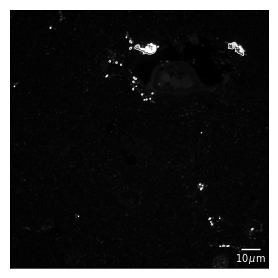

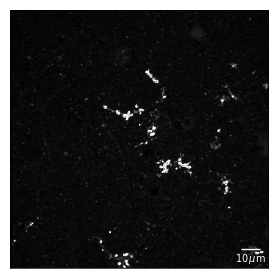

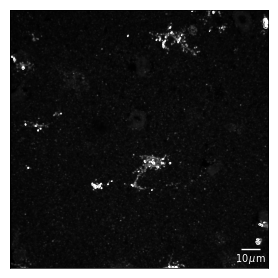

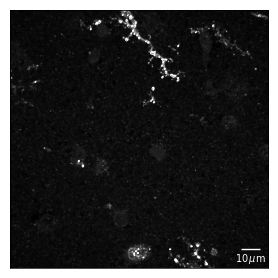

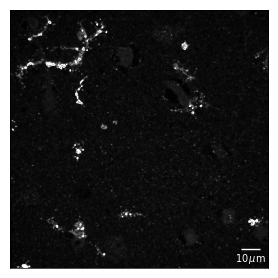

...

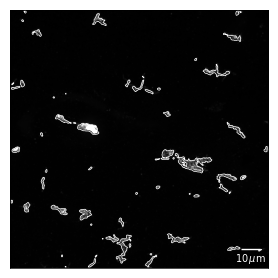

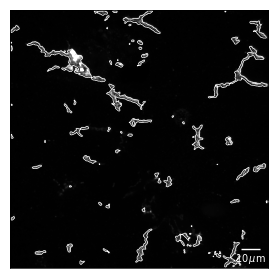

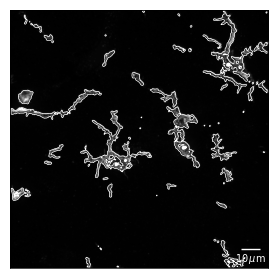

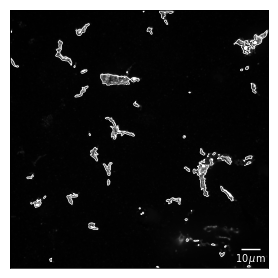

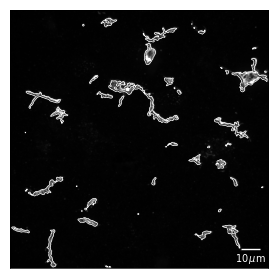

In [6]:
microglia_image_saver(filenames, frontal_region, folder_to_save, lower_object_size=0, lower_hole_size=0)

In [8]:
from skimage.filters import gaussian, threshold_li
def detect_large_features(image, filter, sigma1=2.0, sigma2=60.0, hole_threshold=100, cell_threshold=2000):
    large_mask = np.zeros_like(image)
    for i in np.arange(image.shape[0]):
        enhanced_image = gaussian(image[i, :, :], sigma=sigma1, truncate=2.0) - gaussian(
                    image[i, :, :], sigma=sigma2, truncate=2.0
                )
        
        # Create a binary mask for large features based on the threshold
        large_mask[i, :, :] = enhanced_image > filter(enhanced_image)
        
        large_mask[i, :, :] = binary_opening(large_mask[i, :, :], structure=ski.morphology.disk(1))
        large_mask[i, :, :] = binary_closing(large_mask[i, :, :], structure=ski.morphology.disk(5))
    large_mask = ndi.binary_fill_holes(large_mask)
    large_mask = morphology.remove_small_holes(
        large_mask, 
        area_threshold=hole_threshold
    )
    large_mask = morphology.remove_small_objects(
        large_mask, 
        min_size=cell_threshold
    )
    return large_mask.astype(bool)

In [39]:
def microglia_image_saver_3D(filenames, oligomer_analysis, filter, folder_to_save, protein_string='C1', cell_string='C0', lower_object_size=2000, lower_hole_size=100):
    for filename in filenames:
        filename = str(filename)
        specific_image = oligomer_data.filter(pl.col('image_filename') == filename)
        zi = int(np.unique(specific_image['zi'].to_numpy()))
        zf = int(np.unique(specific_image['zf'].to_numpy()))
        cell_filename = filename.split(protein_string+'.tif')[0]+cell_string+'.tif'
        raw_cell_image = IO.read_tiff_tophotons(cell_filename)[zi-1:zf-1, :, :]
        mask = detect_large_features(raw_cell_image, filter, sigma1=2.0, sigma2=40.0, hole_threshold=100, cell_threshold=2000)
        mask_toplot = np.sum(mask, axis=0).clip(0, 1)
        fig, axs = plotter.one_column_plot()
        savestring =  os.path.split(filename)[-1].split(protein_string+'.tif')[0]+cell_string+'_examplemicroglia.jpg'
        axs[0] = plotter.image_plot(axs=axs[0], data=raw_cell_image.sum(axis=0), plotmask=True, mask=mask_toplot, cbar='off', masklinewidth=0.5)
        plt.savefig(os.path.join(folder_to_save, savestring), dpi=600, format='jpg')
        plt.show(block=False)
    return

In [ ]:
folder_to_save = r'C:\Users\jsb92\Cambridge University Dropbox\Joseph Beckwith\Chemistry\Lee\Code\Python\pyRASP\example_images_analysis\For_ASAP_Paper_3DCellThresholdOtsu'
microglia_image_saver_3D(filenames, oligomer_data, ski.filters.threshold_otsu, folder_to_save)

In [78]:
def microglia_image_saver_generator(filename, oligomer_analysis, filter, protein_string='C1', cell_string='C0', lower_object_size=2000, lower_hole_size=100):
    if not os.path.isdir(folder_to_save):
        os.mkdir(folder_to_save)
    filename = str(filename)
    specific_image = oligomer_data.filter(pl.col('image_filename').str.contains(filename, literal=True))
    overall_filename = str(np.unique(specific_image['image_filename'].to_numpy())[0])
    zi = int(np.unique(specific_image['zi'].to_numpy()))
    zf = int(np.unique(specific_image['zf'].to_numpy()))
    cell_filename = overall_filename.split(protein_string+'.tif')[0]+cell_string+'.tif'
    raw_cell_image = IO.read_tiff_tophotons(cell_filename)[zi-1:zf-1, :, :]
    mask = detect_large_features(raw_cell_image, filter, sigma1=2.0, sigma2=40.0, hole_threshold=100, cell_threshold=2000)
    mask_toplot = np.sum(mask, axis=0).clip(0, 1)
    return mask_toplot, raw_cell_image

In [81]:
def microglia_image_saver_specificfile(mask_toplot, raw_cell_image, filename, oligomer_analysis, folder_to_save, xmin, xmax, ymin, ymax, protein_string='C1', cell_string='C0', lower_object_size=2000, lower_hole_size=100):
    if not os.path.isdir(folder_to_save):
        os.mkdir(folder_to_save)
    filename = str(filename)
    specific_image = oligomer_data.filter(pl.col('image_filename').str.contains(filename, literal=True))
    overall_filename = str(np.unique(specific_image['image_filename'].to_numpy())[0])
    fig, axs = plotter.one_column_plot()
    savestring =  os.path.split(overall_filename)[-1].split(protein_string+'.tif')[0]+cell_string+'_examplemicroglia.svg'
    axs[0] = plotter.image_plot(axs=axs[0], data=raw_cell_image.sum(axis=0)[xmin:xmax, ymin:ymax], plotmask=True, mask=mask_toplot[xmin:xmax, ymin:ymax], masklinewidth=0.5)
    plt.savefig(os.path.join(folder_to_save, savestring), dpi=600, format='svg')
    plt.show(block=False)
    return

In [145]:
folder_to_save = r'C:\Users\jsb92\Cambridge University Dropbox\Joseph Beckwith\Chemistry\Lee\Code\Python\pyRASP\example_images_analysis\For_ASAP_Paper_3DCellThresholdOtsu_SpecificGallery'
filename1 = '20231019_MS_R4_S24_SS1 - Position 1 [9]_XY1697740734_Z00_T4_C1.tif'
filename2 = '20231019_MS_R4_S26_SS1 - Position 1 [9]_XY1697744559_Z00_T7_C1.tif'
filename3 = '20231019_MS_R4_S26_SS2 - Position 1 [9]_XY1697744695_Z00_T7_C1.tif'
filename4 = '20231019_MS_R4_S30_SS2 - Position 1 [9]_XY1697744120_Z00_T1_C1.tif'
filename5 = '20231019_MS_R4_S30_SS2 - Position 1 [9]_XY1697744120_Z00_T3_C1.tif'
filename6 = '20231019_MS_R4_S26_SS1 - Position 1 [9]_XY1697744559_Z00_T2_C1.tif'
filename7 = '20231019_MS_R4_S10_SS1 - Position 1 [9]_XY1697721513_Z00_T5_C1.tif'
filename8 = '20231019_MS_R4_S10_SS2 - Position 1 [9]_XY1697721671_Z00_T3_C1.tif'
filename9 = '20231019_MS_R4_S10_SS3 - Position 1 [9]_XY1697721826_Z00_T5_C1.tif'

In [172]:
filename = filename9
mask_toplot, raw_cell_image = microglia_image_saver_generator(filename, oligomer_data, ski.filters.threshold_otsu)

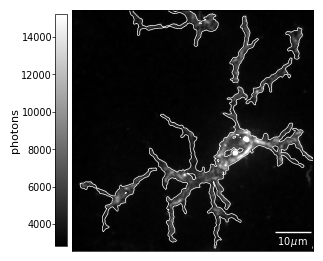

In [181]:
microglia_image_saver_specificfile(mask_toplot, raw_cell_image, filename, oligomer_data, folder_to_save, 270, 870, 50, 650)